In [1]:
from pathlib import Path

In [2]:
# Installation in case running over Colab
try:
    import google.colab
    on_colab = True
    %pip install estival
    %pip install pylatex==1.4.1
    %pip install kaleido
    ! git clone https://github.com/monash-emu/aust-covid
    %cd aust-covid
    %pip install -e ./
    PROJECT_PATH = Path().resolve()
    import multiprocessing as mp
    mp.set_start_method('forkserver')
except:
    PROJECT_PATH = Path().resolve().parent
    on_colab = False

    
    optimise_model = False
new_calibration = False

DATA_PATH = PROJECT_PATH / 'data'
OUTPUT_PATH = PROJECT_PATH / 'outputs'
SUPPLEMENT_PATH = PROJECT_PATH / 'supplement'
Path(OUTPUT_PATH).mkdir(parents=True, exist_ok=True)

In [3]:
import pandas as pd
pd.options.plotting.backend = 'plotly'
from datetime import datetime
import pymc as pm
import arviz as az
import numpy as np
import plotly.express as px

from summer2.functions.time import get_linear_interpolation_function, Function
from summer2.parameters import Parameter
from estival.model import BayesianCompartmentalModel
from estival.wrappers.nevergrad import optimize_model
from estival.priors import UniformPrior
import estival.targets as est
from estival.wrappers import pymc as epm
from autumn.infrastructure.remote import springboard
from autumn.core.runs import ManagedRun

from aust_covid import model
from general_utils import calibration_utils
from aust_covid.inputs import load_calibration_targets, load_who_data, load_serosurvey_data
from general_utils.calibration_utils import round_sigfig, sample_idata, get_sampled_outputs, melt_spaghetti
from general_utils.parameter_utils import load_param_info
from general_utils.doc_utils import TextElement, TableElement, FigElement, add_element_to_document, \
    save_pyplot_add_to_doc, save_plotly_add_to_doc, compile_doc, generate_doc

In [4]:
targets_rolling_window = 7
smoothed_composite_cases, cases_targets_text = load_calibration_targets(datetime(2021, 12, 15), targets_rolling_window)
cases_targets_text

'Official COVID-19 data for Australian through 2022 were obtained from https://www.health.gov.au/health-alerts/covid-19/weekly-reporting on the 2nd of May 2023. Data that extended back to 2021 were obtained from Our World in Data (attribution: https://github.com/owid/covid-19-data/tree/master/public/data#license) on the 16th of June 2023, downloaded from https://github.com/owid/covid-19-data/blob/master/public/data/jhu/full_data.csv and filtered to the Australian data only.The final calibration target for cases was constructed as the OWID data for 2021 concatenated with the Australian Government data for 2022. These daily case data were then smoothed using a {rolling_window}-day moving average. '

In [5]:
death_data, death_targets_text = load_who_data(targets_rolling_window)
death_targets_text

"The daily time series of deaths for Australia was obtained from the World Heath Organization's 'Coronavirus (COVID-19) Dashboard, at https://covid19.who.int/WHO-COVID-19-global-data.csv, downloaded on 18th July 2023. These daily deaths data were then smoothed using a 7-day moving average. "

In [6]:
# Times
start_date = datetime(2021, 7, 1)  # Analysis start time
end_date = datetime(2022, 10, 1)  # Analysis end time
plot_start_date = datetime(2021, 12, 1)  # Left end for plots
ref_date = datetime(2019, 12, 31)  # Arbitrary reference date

In [7]:
# Parameters
parameters = {
    'ba1_seed_time': 620.0,
    'start_cdr': 0.3,
    'contact_rate': 0.07,
    'vacc_prop': 0.4,
    'infectious_period': 2.5,
    'natural_immunity_period': 60.0,
    'ba2_seed_time': 660.0,
    'ba2_escape': 0.4,
    'ba5_seed_time': 715.0,
    'ba5_escape': 0.54,
    'latent_period': 1.8,
    'seed_rate': 1.0,
    'seed_duration': 10.0,
    'notifs_shape': 2.0,
    'notifs_mean': 4.0,
    'vacc_infect_protect': 0.4,
    'rural_susc_adj': 1.0,
    'wa_reopen_period': 30.0,
    'deaths_shape': 2.0,
    'deaths_mean': 20.0,
    'ifr_0': 0.0,
    'ifr_5': 0.0,
    'ifr_10': 0.0,
    'ifr_15': 2.6e-5,
    'ifr_20': 2.6e-5,
    'ifr_25': 2.6e-5,
    'ifr_30': 2.6e-5,
    'ifr_35': 5.8e-5,
    'ifr_40': 5.8e-5,
    'ifr_45': 5.8e-5,
    'ifr_50': 14.6e-5,
    'ifr_55': 14.6e-5,
    'ifr_60': 24.6e-5,
    'ifr_65': 24.6e-5,
    'ifr_70': 246e-5,
    'ifr_75': 246e-5,
}
param_info = load_param_info(PROJECT_PATH / 'inputs/parameters.yml', parameters)
# param_info

In [8]:
doc_sections = {}
compartments = [
    'susceptible',
    'latent',
    'infectious',
    'recovered',
    'waned',
]
aust_model, build_text = model.build_base_model(ref_date, compartments, start_date, end_date)
# add_element_to_document("Model construction", TextElement(build_text), doc_sections)
# build_text

In [9]:
age_strata = list(range(0, 80, 5))

In [10]:
pop_data, pop_text = model.get_pop_data(age_strata)
# add_element_to_document("Model construction", TextElement(pop_text), doc_sections, subsection_name="Population")
# pop_text

In [11]:
start_text = model.set_starting_conditions(aust_model, pop_data)
# add_element_to_document("Model construction", TextElement(start_text), doc_sections, subsection_name="Population")
# start_text

In [12]:
infect_text = model.add_infection(aust_model)
# add_element_to_document("Model construction", TextElement(infect_text), doc_sections)
# infect_text

In [13]:
prog_text = model.add_progression(aust_model)
# add_element_to_document("Model construction", TextElement(prog_text), doc_sections)
# prog_text

In [14]:
rec_text = model.add_recovery(aust_model)
# add_element_to_document("Model construction", TextElement(rec_text), doc_sections)
# rec_text

In [15]:
wane_text = model.add_waning(aust_model)
# add_element_to_document("Model construction", TextElement(wane_text), doc_sections)
# wane_text

In [16]:
raw_mob_df, raw_mob_fig, raw_mob_filename, raw_mob_text = model.get_raw_mobility(plot_start_date, aust_model)
# add_element_to_document("Mobility", TextElement(raw_mob_text), doc_sections)
# raw_mob_text

In [17]:
add_element_to_document("Mobility", FigElement(raw_mob_filename), doc_sections)
# raw_mob_fig

In [18]:
work_mob, mean_smoothed_non_resi_mob, modelled_mob_fig, modelled_mob_filename = model.process_mobility(raw_mob_df, plot_start_date, aust_model)
# add_element_to_document("Mobility", FigElement(modelled_mob_filename), doc_sections)
# modelled_mob_fig

In [19]:
# Calibrated parameters if the exponent parameter for mobility scaling is set to one
exponent = 0.0
if False:
    parameters.update(
        {
            'contact_rate': 0.105,
            'infectious_period': 2.0,
            'ba1_seed_time': 645.0,
            'ba2_seed_time': 675.0,
            'ba5_seed_time': 730.0,
            'ba2_escape': 0.6,
            'ba5_escape': 0.7,
            'natural_immunity_period': 60.0,
        }
    )
    exponent = 2.0

In [20]:
infection_func = model.calculate_mobility_effect(
    mean_smoothed_non_resi_mob, 
    plot_start_date, 
    aust_model,
    exponent,
)
work_func = model.calculate_mobility_effect(
    work_mob,
    plot_start_date,
    aust_model,
    exponent,
)
# add_element_to_document("Mobility", TextElement(mob_adj_text), doc_sections)
# mob_adj_text

In [21]:
# add_element_to_document("Mobility", FigElement(mob_effect_filename), doc_sections)
# mob_effect_fig

In [22]:
mobility_scaling, mob_map_text = model.get_mobility_mapper()
# add_element_to_document("Mobility", TextElement(mob_map_text), doc_sections)
# mob_map_text

In [23]:
locations = [
    'school', 
    'home', 
    'work', 
    'other_locations',
]
raw_location_matrices = {i: pd.read_csv(DATA_PATH / f'{i}.csv', index_col=0).to_numpy() for i in locations}
input_pop_caption, input_pop_filename, modelled_pop_caption, modelled_pop_filename, \
    matrix_ref_pop_fig, matrix_ref_pop_caption, matrix_ref_pop_filename, \
    adjusted_matrices, pop_splits, mat_adj_text = model.adapt_gb_matrices_to_aust(age_strata, raw_location_matrices, pop_data)
mixing_matrix = sum(list(adjusted_matrices.values()))
# mixing_matrix = Function(
#     mobility_scaling, 
#     [
#         adjusted_matrices,
#         work_func,
#         infection_func,
#     ]
# )

In [24]:
# add_element_to_document("Mixing", TextElement(mat_adj_text), doc_sections)
# mat_adj_text

In [25]:
# input_pop_fig.layout.title.update({"text": input_pop_caption})
# input_pop_fig

In [26]:
# modelled_pop_fig.layout.title.update({"text": modelled_pop_caption})
# add_element_to_document("Mixing", FigElement(modelled_pop_filename, caption=modelled_pop_caption), doc_sections)
# modelled_pop_fig

In [27]:
# matrix_ref_pop_fig.layout.title.update({"text": matrix_ref_pop_caption})
# add_element_to_document("Mixing", FigElement(matrix_ref_pop_filename, caption=matrix_ref_pop_caption), doc_sections)
# matrix_ref_pop_fig

In [28]:
# raw_matrix_filename = "raw_matrices"
# raw_matrix_fig, raw_matrix_fig_text = model.plot_mixing_matrices(raw_location_matrices, locations, age_strata, raw_matrix_filename + ".jpg")
# add_element_to_document("Mixing", FigElement(raw_matrix_filename, caption=raw_matrix_fig_text), doc_sections)
# raw_matrix_fig

In [29]:
# adjusted_matrix_filename = "adjusted_matrices"
# adjusted_matrix_fig, adjusted_matrix_fig_text = model.plot_mixing_matrices(raw_location_matrices, locations, age_strata, adjusted_matrix_filename + ".jpg")
# add_element_to_document("Mixing", FigElement(adjusted_matrix_filename, caption=adjusted_matrix_fig_text), doc_sections)
# adjusted_matrix_fig

In [30]:
# This was temporary code while the scaling matrix was switched off
# mixing_matrix = sum(adjusted_matrices.values())
# from plotly import express as px
# px.imshow(mixing_matrix)

In [31]:
age_strat, agestrat_text = model.get_age_stratification(compartments, age_strata, mixing_matrix)
aust_model.stratify_with(age_strat)
# add_element_to_document("Age stratification", TextElement(agestrat_text), doc_sections)
# agestrat_text

In [32]:
strain_strata = [
    'ba1', 
    'ba2', 
    'ba5',
]
strain_strat, strainstrat_text = model.get_strain_stratification(compartments, strain_strata)
aust_model.stratify_with(strain_strat)
# add_element_to_document("Strain stratification", TextElement(strainstrat_text), doc_sections)
# strainstrat_text

In [33]:
seed_text = model.seed_vocs(aust_model)
# add_element_to_document("Strain stratification", TextElement(seed_text), doc_sections)
# seed_text

In [34]:
reinfect_text = model.add_reinfection(aust_model, strain_strata, infection_func)
# add_element_to_document("Strain stratification", TextElement(reinfect_text), doc_sections)
# reinfect_text

In [35]:
infection_processes = [
    'infection', 
    'early_reinfection',
    'late_reinfection',
]
inc_text = model.add_incidence_output(aust_model, infection_processes)
add_element_to_document('Outputs', TextElement(inc_text), doc_sections)
# inc_text

In [36]:
ratio_df, survey_fig, survey_fig_name, survey_fig_caption, ratio_fig, ratio_fig_name, ratio_fig_caption, cdr_description = model.add_notifications_output(aust_model)
# add_element_to_document("Outputs", TextElement(cdr_description), doc_sections, subsection_name="Notifications")
# add_element_to_document("Outputs", FigElement(survey_fig_name, caption=survey_fig_caption), doc_sections, subsection_name="Notifications")
# add_element_to_document("Outputs", FigElement(ratio_fig_name, caption=ratio_fig_caption), doc_sections, subsection_name="Notifications")
# cdr_description

In [37]:
# survey_fig.layout.title.update({"text": survey_fig_caption})
# survey_fig

In [38]:
# ratio_fig.layout.title.update({"text": ratio_fig_caption})
# ratio_fig

In [39]:
model.track_sero_prevalence(compartments, aust_model)

'Seroprevalence is calculated as the proportion of the population ever leaving the susceptible compartment. '

In [40]:
strain_prop_text = model.track_strain_prop(strain_strata, aust_model)
# add_element_to_document("Outputs", TextElement(strain_prop_text), doc_sections, subsection_name="Other outputs")
# strain_prop_text

In [41]:
# Vaccination stratification - code needs commenting, etc.
vacc_strat = model.get_vacc_stratification(compartments, infection_processes)
aust_model.stratify_with(vacc_strat)

In [42]:
# Spatial/state stratification
state_pop_dist = pop_data.sum() / pop_data.sum().sum()
wa_reopen_times = []
spatial_strat = model.get_spatial_stratification(datetime(2022, 3, 3), compartments, infection_processes, state_pop_dist.to_dict(), aust_model)
aust_model.stratify_with(spatial_strat)
model.adjust_state_pops(pop_data, state_pop_dist, aust_model)

In [43]:
model.track_reproduction_number(aust_model, infection_processes)

In [44]:
model.track_child_adult_sero_prevalence(compartments, aust_model, 20)

In [45]:
model.track_age_specific_incidence(aust_model, infection_processes)
model.add_death_output(aust_model)

In [46]:
lagged_serosurvey_data, serosurvey_text = load_serosurvey_data(14)
serosurvey_text

'We obtained estimates of the seroprevalence of antibodies to nucleocapsid antigen from Australia blood donors from Kirby Institute serosurveillance reports. Data are available from round 4 survey, available at https://www.kirby.unsw.edu.au/sites/default/files/documents/COVID19-Blood-Donor-Report-Round4-Nov-Dec-2022_supplementary%5B1%5D.pdf. Information on assay sensitivity is available at: https://www.kirby.unsw.edu.au/sites/default/files/documents/COVID19-Blood-Donor-Report-Round1-Feb-Mar-2022%5B1%5D.pdfWe lagged these estimates by 14 to account for the delay between infection and seroconversion. '

In [47]:
# Calibration/optimisation settings
priors = [
    UniformPrior('ba1_seed_time', (570.0, 670.0)), 
    UniformPrior('contact_rate', (0.03, 0.1)),
    UniformPrior('infectious_period', (2.5, 7.0)),
    UniformPrior('start_cdr', (0.25, 0.5)),
    UniformPrior('latent_period', (1.5, 4.0)),
]
targets = [
    est.TruncatedNormalTarget('notifications', smoothed_composite_cases, [0.0, np.inf], smoothed_composite_cases.max() * 0.1),
    est.TruncatedNormalTarget('deaths', death_data, [0.0, np.inf], death_data.max() * 0.1),
    est.BinomialTarget('adult_seropos_prop', lagged_serosurvey_data, pd.Series([20] * 4, index=lagged_serosurvey_data.index)),
]
calibration_model = BayesianCompartmentalModel(aust_model, parameters, priors, targets)

In [48]:
if optimise_model:
    with pm.Model() as pmc_model:
        start_params = {k: np.clip(v, *calibration_model.priors[k].bounds(0.99)) for k, v in parameters.items() if k in calibration_model.priors}
        variables = epm.use_model(calibration_model)
        map_params = pm.find_MAP(start=start_params, vars=variables, include_transformed=False)
        map_params = {k: float(v) for k, v in map_params.items()}
    print('Best calibration parameters found:')
    for i_param, param in enumerate(map_params):
        print(f'   {param}: {round_sigfig(map_params[param], 4)} (within bound {priors[i_param].bounds()}')

In [49]:
# For a video of the scaling of the mixing matrix over time
# model.video_mixing_matrices(aust_model)

In [50]:
# Inspect parameters
parameters

{'ba1_seed_time': 620.0,
 'start_cdr': 0.3,
 'contact_rate': 0.07,
 'vacc_prop': 0.4,
 'infectious_period': 2.5,
 'natural_immunity_period': 60.0,
 'ba2_seed_time': 660.0,
 'ba2_escape': 0.4,
 'ba5_seed_time': 715.0,
 'ba5_escape': 0.54,
 'latent_period': 1.8,
 'seed_rate': 1.0,
 'seed_duration': 10.0,
 'notifs_shape': 2.0,
 'notifs_mean': 4.0,
 'vacc_infect_protect': 0.4,
 'rural_susc_adj': 1.0,
 'wa_reopen_period': 30.0,
 'deaths_shape': 2.0,
 'deaths_mean': 20.0,
 'ifr_0': 0.0,
 'ifr_5': 0.0,
 'ifr_10': 0.0,
 'ifr_15': 2.6e-05,
 'ifr_20': 2.6e-05,
 'ifr_25': 2.6e-05,
 'ifr_30': 2.6e-05,
 'ifr_35': 5.8e-05,
 'ifr_40': 5.8e-05,
 'ifr_45': 5.8e-05,
 'ifr_50': 0.000146,
 'ifr_55': 0.000146,
 'ifr_60': 0.000246,
 'ifr_65': 0.000246,
 'ifr_70': 0.00246,
 'ifr_75': 0.00246}

In [51]:
aust_model.run(parameters=parameters)
# axis_labels = {"index": "time", "value": "cases"}
comparison_df = pd.concat((smoothed_composite_cases, aust_model.get_derived_outputs_df()["notifications"]), axis=1)
# fig = comparison_df.plot(labels=axis_labels)
# fig.update_xaxes(range=(start_date, end_date))
# fig

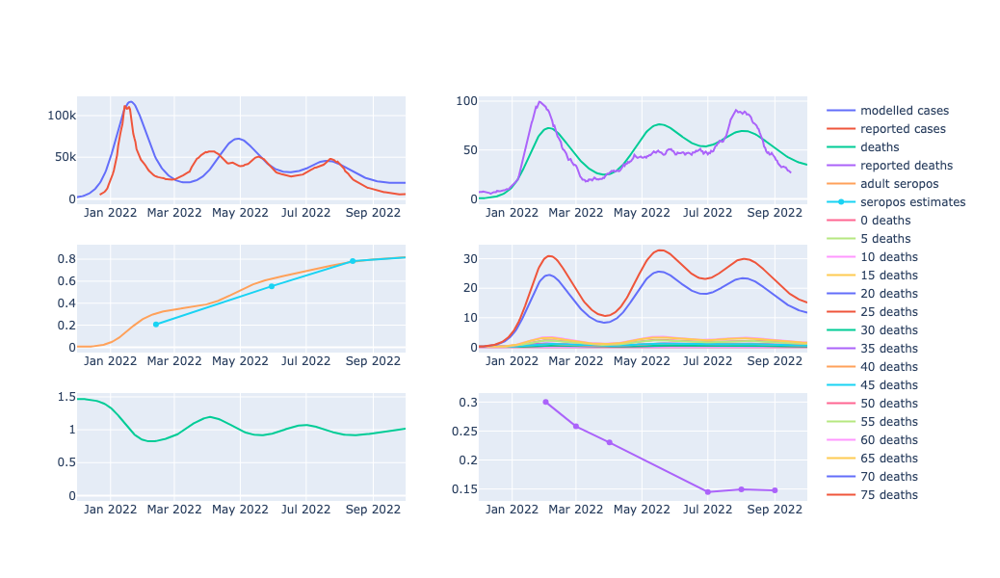

In [52]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

exp_param = model.get_param_to_exp_plateau(ratio_df[0], parameters['start_cdr'])
fig = make_subplots(rows=3, cols=2)
derived_outputs = aust_model.get_derived_outputs_df()
x_vals = derived_outputs.index
fig.add_trace(go.Scatter(x=x_vals, y=derived_outputs['notifications'], name='modelled cases'), row=1, col=1)
fig.add_trace(go.Scatter(x=x_vals, y=comparison_df[0], name='reported cases'), row=1, col=1)
fig.add_trace(go.Scatter(x=x_vals, y=derived_outputs['deaths'], name='deaths'), row=1, col=2)
fig.add_trace(go.Scatter(x=death_data.index, y=death_data, name='reported deaths'), row=1, col=2)
fig.add_trace(go.Scatter(x=x_vals, y=derived_outputs['adult_seropos_prop'], name='adult seropos'), row=2, col=1)
fig.add_trace(go.Scatter(x=lagged_serosurvey_data.index, y=lagged_serosurvey_data, name='seropos estimates'), row=2, col=1)
for agegroup in age_strata:
    fig.add_trace(go.Scatter(x=x_vals, y=derived_outputs[f'deathsXagegroup_{agegroup}'], name=f'{agegroup} deaths'), row=2, col=2)
cdr_values = model.get_cdr_values(exp_param, ratio_df)
fig.add_trace(go.Scatter(x=x_vals, y=derived_outputs['reproduction_number'], name='reproduction number'), row=3, col=1)
fig.add_trace(go.Scatter(x=cdr_values.index, y=cdr_values, name='CDR'), row=3, col=2)
fig.update_xaxes(range=(plot_start_date, end_date))
# fig.add_trace(go.Scatter(x=mobility_adjuster.index, y=mobility_adjuster, name='mobility scaler'), row=3, col=1)
fig.update_layout(height=600, width=1200)
fig.show()

In [53]:
seropos_prop = aust_model.get_derived_outputs_df()['seropos_prop']
ever_infected_stats = pd.DataFrame(
    {
        'seropos': seropos_prop,
        'seroneg': 1.0 - seropos_prop,
    },
)
# fig = ever_infected_stats.plot.area(title="Ever infected")
# fig.update_xaxes(range=(start_date, end_date))
# fig.update_yaxes(range=(0.0, 1.0))

In [54]:
comparison_df = pd.concat((smoothed_composite_cases, aust_model.get_derived_outputs_df()['notifications']), axis=1)
# fig = comparison_df.plot()
# fig.update_xaxes(range=(start_date, end_date))
# fig

In [55]:
# strain_prop_fig, strain_prop_fig_name, strain_prop_fig_caption = model.show_strain_props(strain_strata, datetime(2021, 11, 1), aust_model)
# add_element_to_document("Outputs", FigElement(strain_prop_fig_name, caption=strain_prop_fig_caption), doc_sections, subsection_name="Sub-variants")
# strain_prop_fig.layout.title.update({"text": strain_prop_fig_caption})
# strain_prop_fig

In [56]:
exp_param = model.get_param_to_exp_plateau(ratio_df[0], parameters["start_cdr"])
# print(f"modelled CDR is {round_sigfig(model.get_cdr_values(exp_param, ratio_df)[0], 4)}")
# model.get_cdr_values(exp_param, ratio_df).plot()

In [81]:
def run_calibration(bridge: springboard.task.TaskBridge, calibration_model: BayesianCompartmentalModel):
    import multiprocessing as mp
    mp.set_start_method('forkserver')

    # Chains should be at least dimensionality + 1
    # Cores should be a whole number factor of chains and from 1 to 2x the number of physical cores
    # Consider increasing to 16 chains on 8 or 16 cores if more than 7 parameters
    
    with pm.Model() as pm_model:
        variables = epm.use_model(calibration_model)
        idata_raw = pm.sample(step=[pm.DEMetropolis(variables)], draws=10000, tune=0, cores=8, chains=8, progressbar=False)
    
    idata_raw.to_netcdf(str(bridge.out_path / 'calibration_out.nc'))

    bridge.logger.info('Calibration complete')

In [82]:
mspec = springboard.EC2MachineSpec(8, 2, 'compute')

# Wrap our function; the first argument is supplied by the runner, the rest must be kwargs
# Note that these arguments should (where possible) be built-in python data types (or at least nothing too exotic)
tspec = springboard.TaskSpec(run_calibration, {'calibration_model': calibration_model})

In [83]:
run_path = springboard.launch.get_autumn_project_run_path('aust_covid', 'initial_exploration', 'first_go')
run_path

'projects/aust_covid/initial_exploration/2023-07-26T1657-first_go'

In [85]:
# This should be fairly resilient to failure, however if you do receive any kind of error or Exception here,
# please tell David ASAP!
# It is possible you will get some "SSH connection will waiting, retrying" messages; please also report these
# - they're not a 'failure', just AWS being a bit slow...
aust_covid_commands = [
    'git clone --branch main https://github.com/monash-emu/aust-covid',
    'pip install -e ./aust-covid',
]
runner = springboard.launch.launch_synced_autumn_task(tspec, mspec, run_path,branch=None, extra_commands=aust_covid_commands)

In [93]:
# Wait until the task is complete - it might take a few minutes...
runner.wait()

'SUCCESS'

In [94]:
# This should print out a a log containing the text from our wrapped task...
print(runner.get_log())

In [95]:
mr = ManagedRun(run_path)

In [96]:
mr.remote.list_contents()

['projects/aust_covid/initial_exploration/2023-07-26T1657-first_go/.taskmeta/STATUS',
 'projects/aust_covid/initial_exploration/2023-07-26T1657-first_go/.taskmeta/instance.json',
 'projects/aust_covid/initial_exploration/2023-07-26T1657-first_go/.taskmeta/task_spec.yml',
 'projects/aust_covid/initial_exploration/2023-07-26T1657-first_go/.taskmeta/taskscript.sh',
 'projects/aust_covid/initial_exploration/2023-07-26T1657-first_go/log/task.log',
 'projects/aust_covid/initial_exploration/2023-07-26T1657-first_go/output/calibration_out.nc']

In [97]:
mr.remote.download(mr.remote.list_contents()[-1])

In [112]:
idata = az.from_netcdf(mr.list_local()[-1])

In [100]:
# Adjust this burnin progressively until you get a sensible trace/decent summary stats...
burnin = 0

idata = idata_raw.sel(draw=np.s_[burnin:])

az.summary(idata)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
ba1_seed_time,590.320,14.743,570.051,617.741,0.339,0.240,1705.0,2221.0,1.00
contact_rate,0.054,0.011,0.034,0.071,0.000,0.000,782.0,806.0,1.01
infectious_period,3.585,0.962,2.500,5.511,0.035,0.025,495.0,270.0,1.02
start_cdr,0.299,0.040,0.250,0.373,0.001,0.001,1938.0,2410.0,1.00
latent_period,2.443,0.662,1.500,3.639,0.016,0.011,1546.0,1960.0,1.00


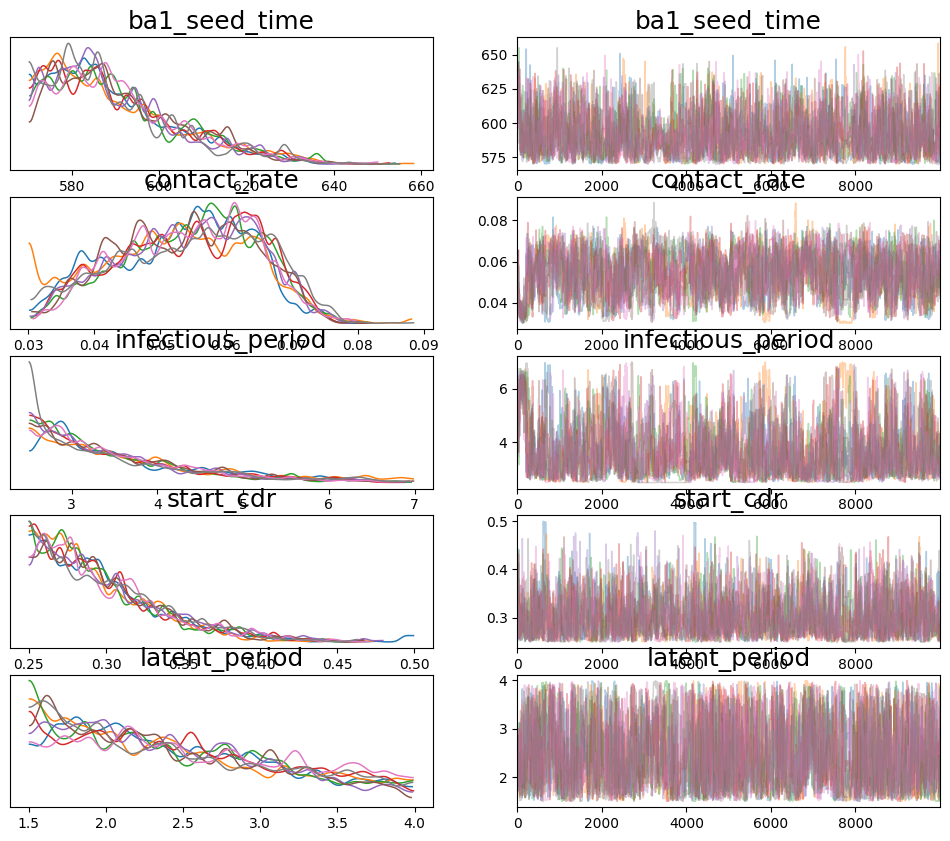

In [101]:
az.plot_trace(idata, compact=False);

In [102]:
# Main calibration loop
iterations = 1000
burn_in = 200
n_chains = 6
if new_calibration:
    with pm.Model() as pm_model:
        variables = epm.use_model(calibration_model)
        idata_raw = pm.sample(step=[pm.DEMetropolis(variables)], draws=iterations, tune=0, cores=6, chains=n_chains)
    idata_raw.to_netcdf(OUTPUT_PATH / "calibration_out.nc")
else:
    idata_raw = az.from_netcdf(OUTPUT_PATH / "calibration_out.nc")

idata = idata_raw.sel(draw=range(burn_in, iterations))  # Discard burn-in

In [103]:
# Check parameter starting points by chain
idata_raw.posterior.isel(draw=0).to_dataframe()

,draw,ba1_seed_time,contact_rate,infectious_period,start_cdr,latent_period
chain,,,,,,
0,0,619.997961,0.065011,4.751160,0.375076,2.750658
1,0,619.984603,0.064963,4.750495,0.374985,2.750229
2,0,620.014581,0.065017,4.748740,0.374932,2.750193
3,0,619.975455,0.064994,4.749681,0.374955,2.749203
4,0,619.986884,0.065003,4.749772,0.375008,2.748943
5,0,620.000523,0.065029,4.751696,0.374954,2.749864


In [104]:
# Report acceptance ratios by chain
(idata.sample_stats.accepted.sum(axis=1) / idata.sample_stats.coords["draw"].size).to_dataframe()

,accepted
chain,
0,0.35500
1,0.38500
2,0.36625
3,0.37500
4,0.38375
5,0.39875


In [105]:
priors_table = calibration_utils.tabulate_priors(priors, param_info)
add_element_to_document("Calibration", TableElement(priors_table), doc_sections)
priors_table

,Distribution,Parameters,Support
BA.1 seed start time,Uniform distribution,loc: 570.0 scale: 100.0,570.0 to 670.0
Effective contact rate,Uniform distribution,loc: 0.03 scale: 0.07,0.03 to 0.1
Infectious period,Uniform distribution,loc: 2.5 scale: 4.5,2.5 to 7.0
Case detection rate,Uniform distribution,loc: 0.25 scale: 0.25,0.25 to 0.5
Latent period,Uniform distribution,loc: 1.5 scale: 2.5,1.5 to 4.0


In [106]:
calib_table = calibration_utils.tabulate_param_results(idata, priors, param_info)
add_element_to_document("Calibration", TableElement(calib_table), doc_sections)
calib_table

,Mean,Standard deviation,ESS bulk,ESS tail,R_hat,High-density interval
BA.1 seed start time,593.0,12.916,41.0,311.0,1.10,573.0 to 618.0
Effective contact rate,0.051,0.007,196.0,384.0,1.04,0.038 to 0.064
Infectious period,3.7,0.688,236.0,262.0,1.03,2.64 to 4.92
Case detection rate,0.3,0.038,202.0,218.0,1.04,0.25 to 0.366
Latent period,2.2,0.387,196.0,266.0,1.04,1.6 to 2.92


In [107]:
param_table = calibration_utils.tabulate_parameters(parameters, priors, param_info)
add_element_to_document("Parameters", TableElement(param_table, col_requests=[0.25, 0.25, 0.5]), doc_sections)

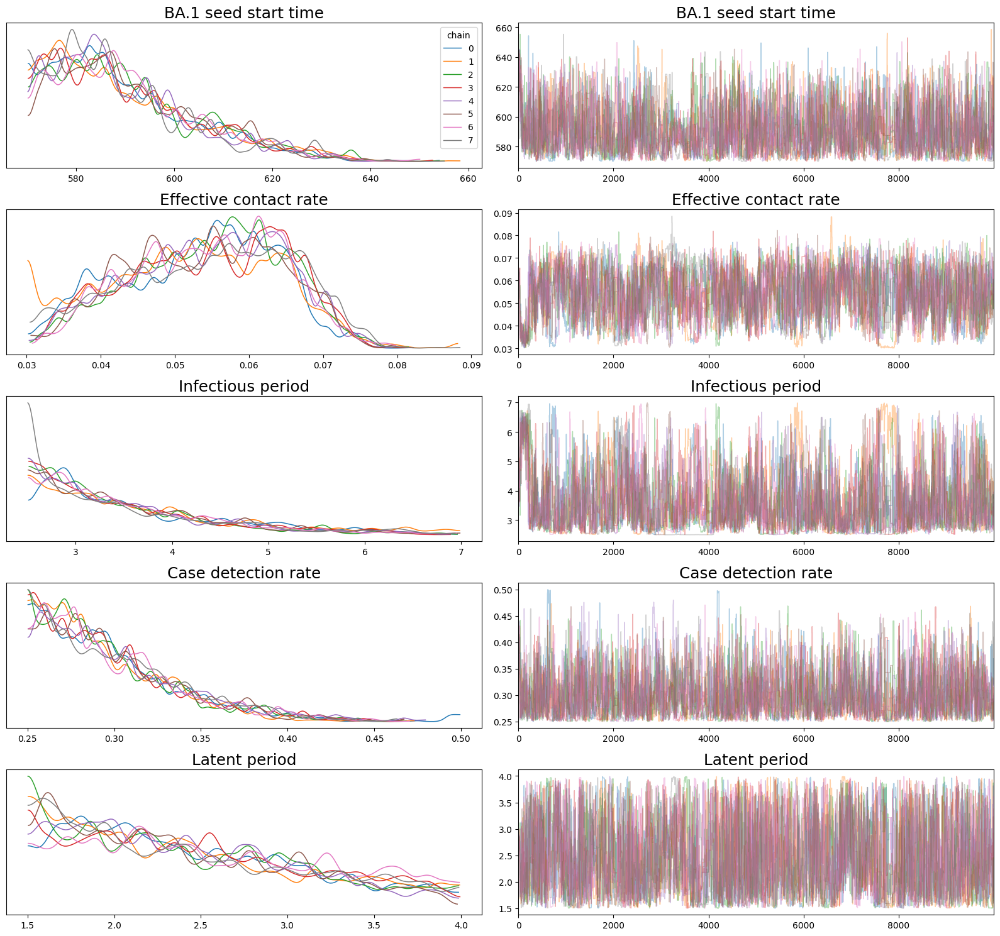

In [113]:
chains_plot = calibration_utils.plot_param_progression(idata, param_info)
save_pyplot_add_to_doc(chains_plot, "chains", "Calibration", doc_sections, caption="Parameter progression and posterior by chain.")

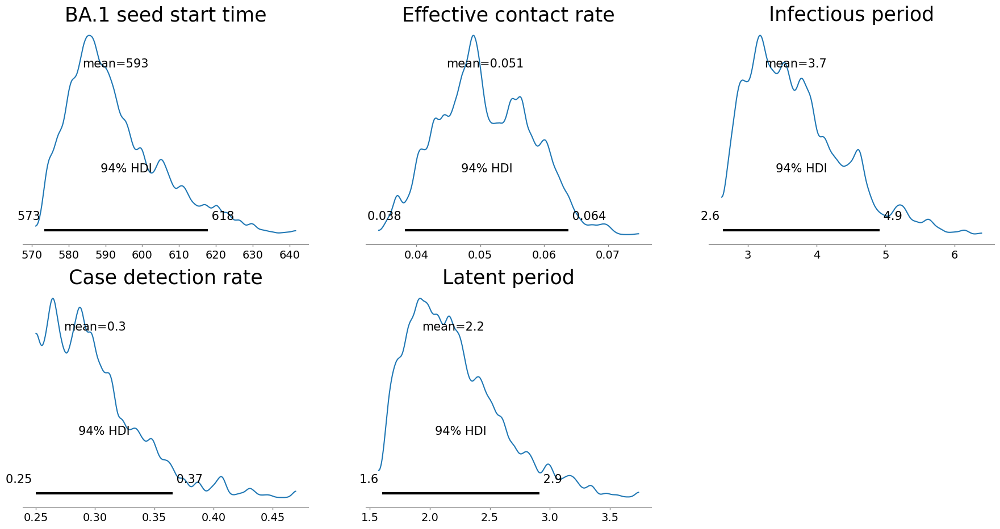

In [109]:
posterior_plot = calibration_utils.plot_param_posterior(idata, param_info)
save_pyplot_add_to_doc(posterior_plot, "posterior", "Calibration", doc_sections, caption="Final estimated parameter posteriors.")

In [116]:
n_samples = 50
sampled_idata = sample_idata(idata, n_samples, calibration_model)
req_outputs = ['notifications', 'adult_seropos_prop', 'deaths']
output_results = get_sampled_outputs(calibration_model, sampled_idata, req_outputs, parameters)

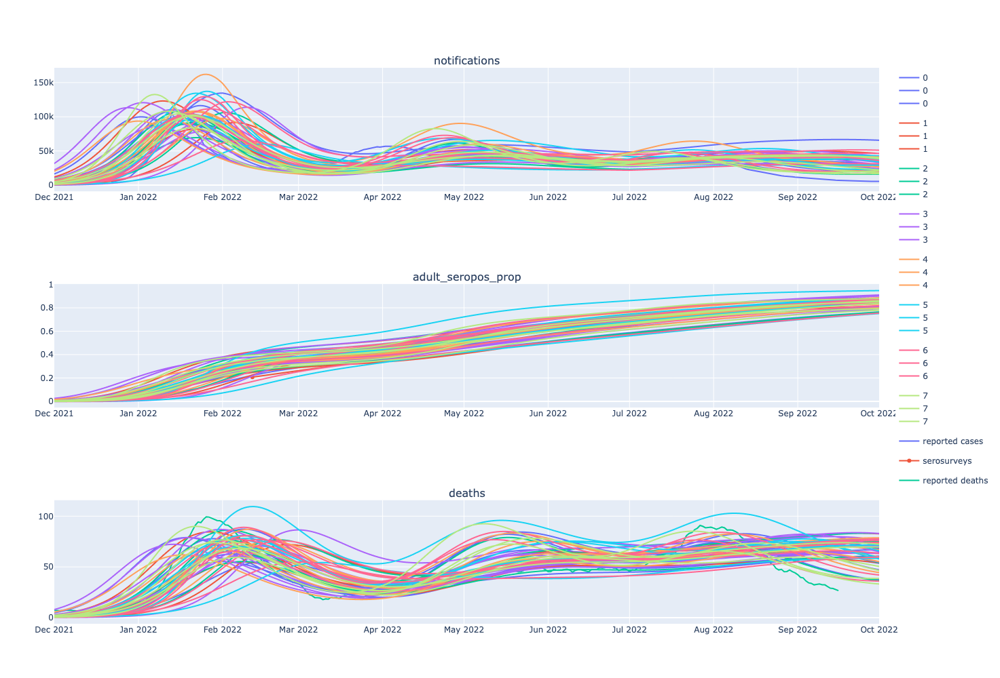

In [117]:
fig = make_subplots(rows=3, cols=1, subplot_titles=req_outputs)
for i_out, out in enumerate(req_outputs):
    spaghetti = melt_spaghetti(output_results, out, sampled_idata)
    lines = px.line(spaghetti, y='value', color='chain', line_group='draw', hover_data=spaghetti.columns)
    fig.add_traces(lines.data, rows=i_out + 1, cols=1)
fig.add_trace(go.Scatter(x=smoothed_composite_cases.index, y=smoothed_composite_cases, name='reported cases'), row=1, col=1)
fig.add_trace(go.Scatter(x=lagged_serosurvey_data.index, y=lagged_serosurvey_data, name='serosurveys'), row=2, col=1)
fig.add_trace(go.Scatter(x=death_data.index, y=death_data, name='reported deaths'), row=3, col=1)
fig.update_xaxes(range=(plot_start_date, end_date))
fig.update_layout(height=1000, width=1000)
fig

In [ ]:
modelled_cdr_fig, modelled_cdr_fig_name, modelled_cdr_fig_caption = model.show_cdr_profiles(sampled_df["start_cdr"], ratio_df)
save_plotly_add_to_doc(modelled_cdr_fig, modelled_cdr_fig_name, "Calibration", doc_sections, caption=modelled_cdr_fig_caption)
modelled_cdr_fig

In [ ]:
# Complete the documentation process
supplement = generate_doc("Supplemental Appendix", "austcovid")
compile_doc(doc_sections, supplement)

In [ ]:
if on_colab:
    # To build a PDF, we need the appropriate tex packages installed
    ! apt-get -y install texlive-latex-base texlive-fonts-recommended texlive-fonts-extra texlive-latex-extra texlive-bibtex-extra biber
    # To avoid clutter and navigate to the right directory
    import os
    os.chdir("supplement")
    # And finally build the formatted PDF, repeated commands are necessary
    ! pdflatex supplement
    ! biber supplement
    ! pdflatex supplement
    ! pdflatex supplement